In [ ]:
%load_ext autoreload
%autoreload 2

In [1]:
contexts = {
    0: "Unknown",
    1: "Separation",
    2: "Biting",
    3: "Feeding",
    4: "Fighting",
    5: "Grooming",
    6: "Isolation",
    7: "Kissing",
    8: "Landing",
    9: "Mating protest",
    10: "Threat-like",
    11: "General",
    12: "Sleeping",
}

### Import packages

In [19]:
import pandas as pd
from pathlib2 import Path
import numpy as np
from avgn_paper.utils.audio import load_wav
import matplotlib.pyplot as plt
%matplotlib inline
import IPython.display
from tqdm.autonotebook import tqdm

from avgn_paper.signalprocessing.spectrogramming import spectrogram
from avgn.utils.audio import load_wav, float32_to_int16, int16_to_float32, write_wav
from avgn.visualization.spectrogram import visualize_spec, plot_spec

### load data

In [4]:
DSLOC = Path('/mnt/cube/Datasets/FruitBat/').resolve()

In [5]:
annotations =  pd.read_csv(DSLOC/'Annotations.csv')

In [7]:
file_info = pd.read_csv('/mnt/cube/Datasets/FruitBat/FileInfo.csv', names = np.arange(50))
file_info.columns = file_info.loc[0].values
file_info = file_info[1:]

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3018: DtypeWarning: Columns (0,1,4,6,7,8,9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [9]:
# get wavs currently on the disk
wavs_on_disk = list(DSLOC.expanduser().glob('files*/'))
wavs_on_disk = [i for i in wavs_on_disk if i.is_dir() == True]
file_info_on_disk = file_info[file_info['File folder'].isin([_dir.name for _dir in wavs_on_disk])]
annotations_on_disk = annotations[annotations['FileID'].isin(list(np.unique(file_info_on_disk.FileID.values)))]

### Make a list of most common emitters

In [10]:
emitter_freq = pd.DataFrame({emm: [np.sum(annotations_on_disk.Emitter == emm)] for emm in np.unique(annotations_on_disk.Emitter)}).T
emitter_freq.columns = ['N_voc']
emitter_freq = emitter_freq.sort_values(by='N_voc', ascending=False)
emitter_freq[:5]

,N_voc
215,2672
-215,2024
230,1971
-231,1339
-230,1286


### loop through most common emitters and plot most common contexts

In [33]:
param_dict = {}
rate= 250000
# parameters for
spectrogramming_params = {
    # spectrograms
    "mel_filter": False,  # should a mel filter be used?
    "num_freq": 2048,  # how many channels to use in a spectrogram
    "preemphasis": 0.97,
    "min_silence_for_spec": 0.5,  # minimum length of silence for a spectrogram to be considered a good spectrogram
    "max_vocal_for_spec": 5.0,  # the longest a single vocalization (protosyllable) is allowed to be
    "frame_shift_ms": 0.05,  # step size for fft
    "frame_length_ms": .5,  # frame length for fft
    "min_level_dB": -70,  # minimum threshold db for computing spe
    "min_level_dB_floor": -20,  # (db)
    "spec_thresh_delta_dB": 5,  # (db) what
    "ref_level_dB": 20,  # reference db for computing spec
    "sample_rate": rate,  # sample rate of your data
}

signal_filter_params = {
    "lowcut": 50,  # Hz # Low cut for our butter bandpass filter
    "highcut": int(rate/2),  # Hz # High cut for our butter bandpass filter
    "rms_window": 0.01,  # seconds # the size of your window
    "rms_stride": 0.01,  # seconds # how big your step size should be for moving the filter
    "noise_thresh": 0.01,  # threshold percent of maximum noise to consider silence
    "segment_padding": 4.0,  # seconds to pad waveform extracted
    "rms_padding": 1.0,  # seconds # how much to pad around vocalizations
}

param_dict["fruitbat"] = {}

for d in [spectrogramming_params, signal_filter_params]:
    for k, v in d.items():
        param_dict["fruitbat"][k] = v

In [36]:
n_indv = 10
n_contexts = 1
nrow = 6
ncol = 10
zoom_x = 3
zoom_y = 2

### sleeping calls

215
Sleeping


/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/signal/signaltools.py:1344: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out = out_full[ind]


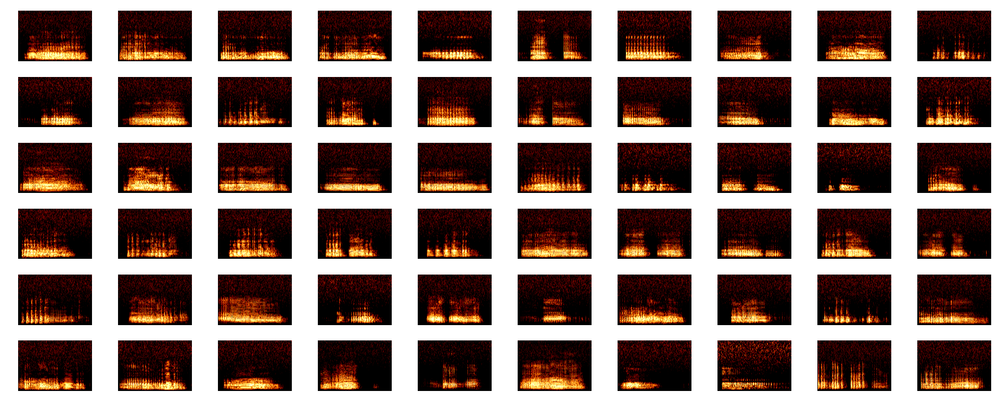


230
Sleeping


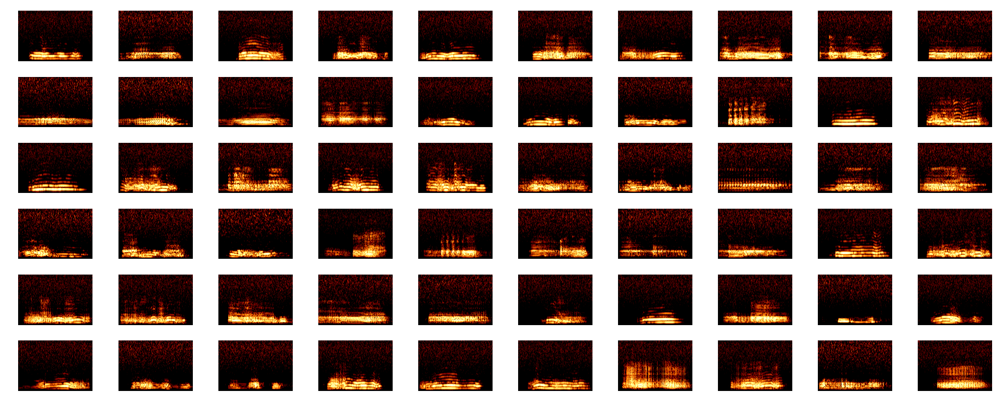


231
Sleeping


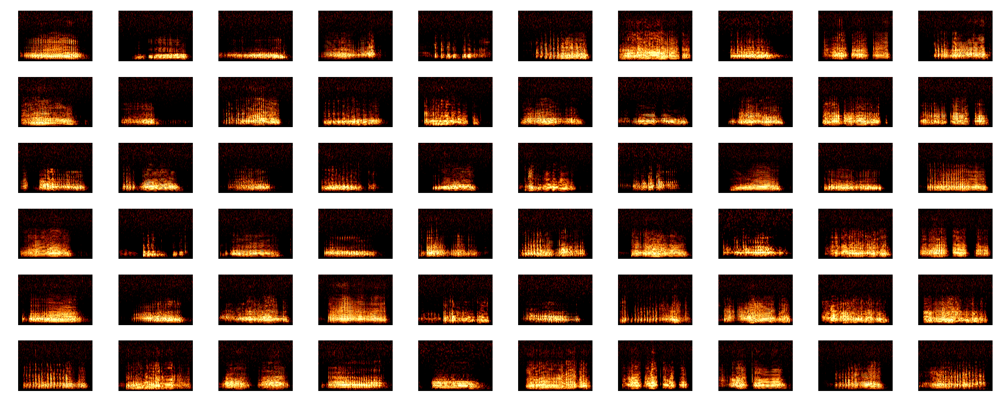


211
Sleeping


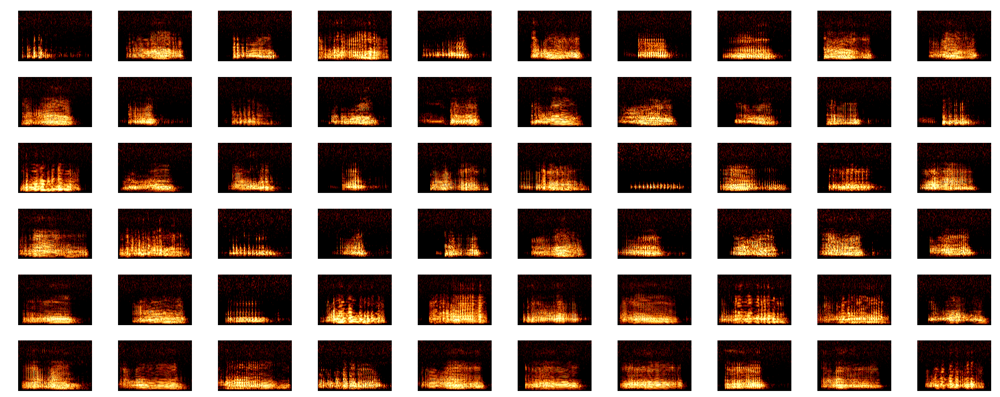


216
Sleeping


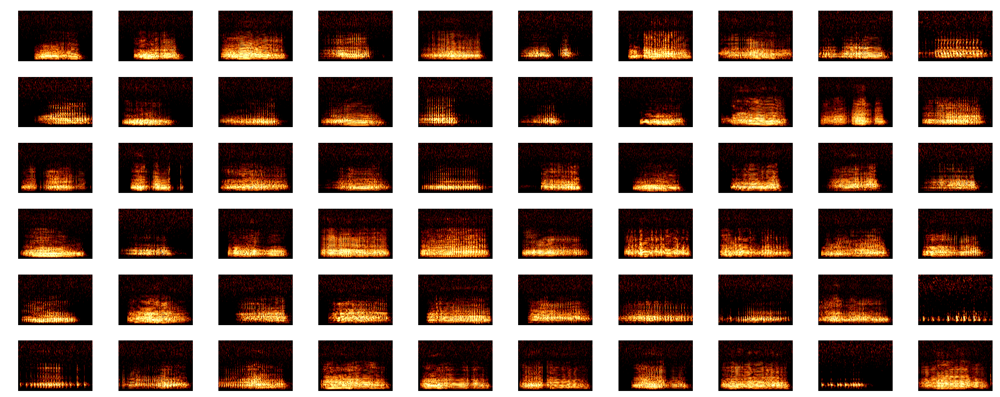


207
Sleeping


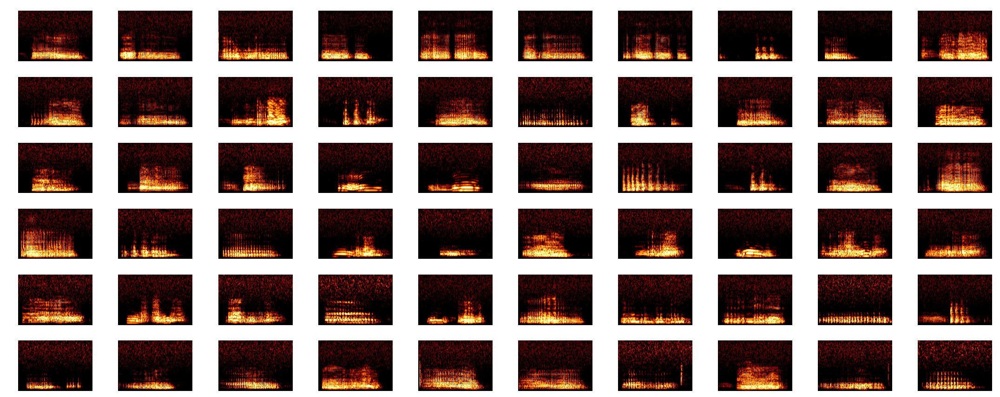


210
Sleeping


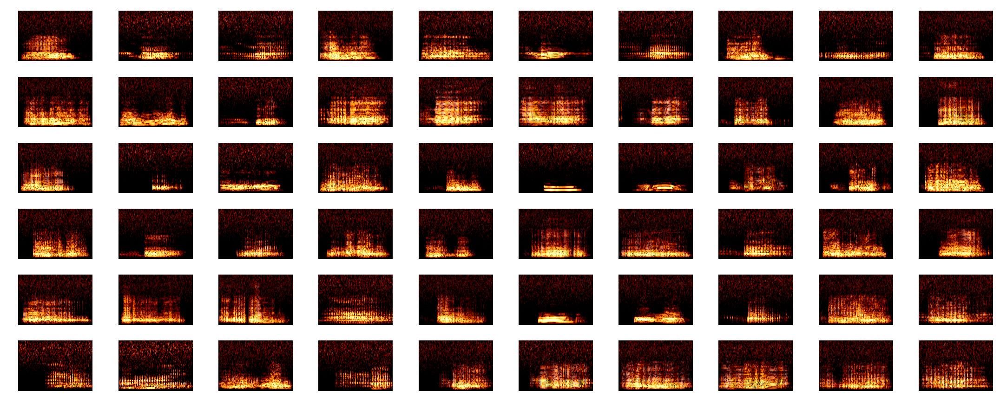


220
Sleeping


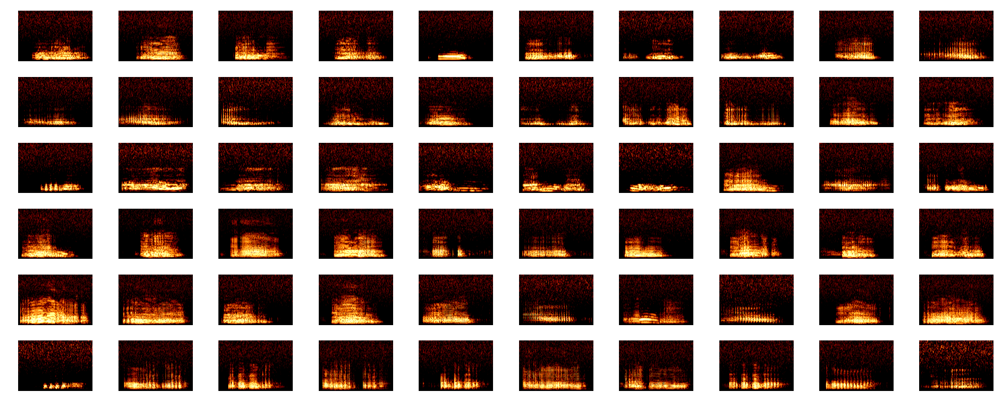


208
Sleeping


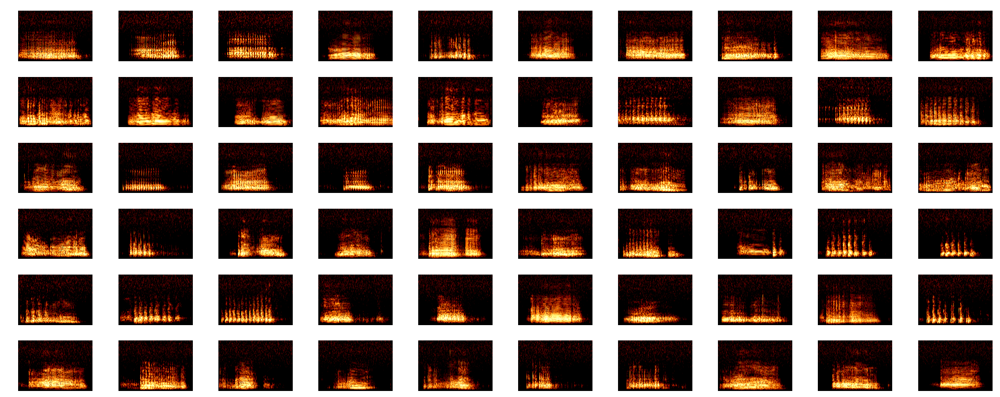


221
Sleeping


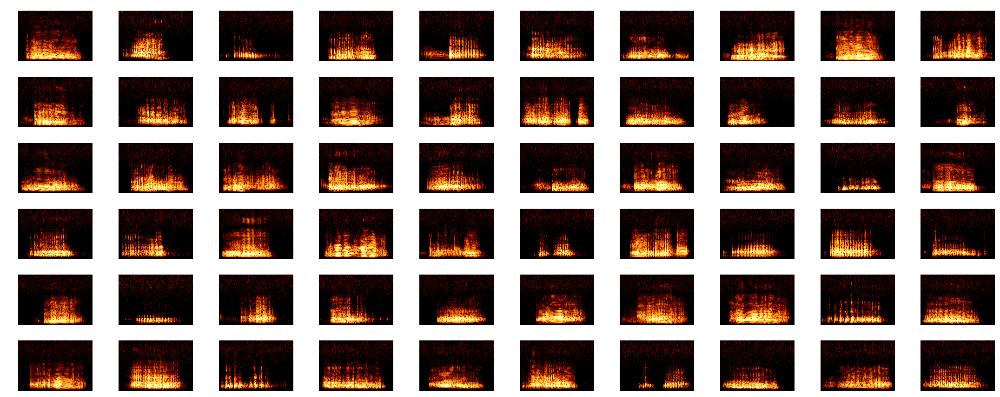

In [37]:
for indv, row in emitter_freq[emitter_freq.index > 0][:n_indv].iterrows():
    print(indv)
    # subset annotated data by that individual
    indv_annotations = annotations_on_disk[annotations_on_disk.Emitter == indv]
    # get context frequency
    indv_context_freq = pd.DataFrame({context: [np.sum(indv_annotations.Context == context)] for context in np.unique(indv_annotations.Context)}).T
    indv_context_freq.columns = ['N_voc']
    indv_context_freq = indv_context_freq.sort_values(by='N_voc', ascending=False)
    indv_context_freq['context']= [contexts[idx] for idx, row in indv_context_freq.iterrows()]
    indv_context_freq = indv_context_freq[indv_context_freq.context == 'Sleeping']

    # loop through
    for ctxt, row in indv_context_freq[:n_contexts].iterrows():
        ctxt_annotations = indv_annotations[indv_annotations.Context == ctxt]
        print(row.context)
        # prepare the figure
        with tqdm(total=ncol*nrow) as pbar:
            pbar.set_description("examples")
            nex = 0
            fig, axs = plt.subplots(nrows = nrow, ncols=ncol, figsize=(ncol*zoom_x, nrow*zoom_y))
            for idx, row in ctxt_annotations.iterrows():    
                # get wav location of data
                voc_info = file_info_on_disk[file_info_on_disk.FileID == row.FileID]
                wav_path = DSLOC / voc_info['File folder'].values[0] / voc_info['File name'].values[0]
                # get start and end times from this file
                start_times = voc_info.values[:,6:][pd.isnull(voc_info.values[:,6:]) == False][::2]
                # get start and end times from this file
                end_times = voc_info.values[:,6:][pd.isnull(voc_info.values[:,6:]) == False][1:][::2]
                # load the data
                rate, data = load_wav(wav_path)
                for st, et in zip(start_times, end_times):
                    wav_spectrogram = spectrogram(int16_to_float32(data[int(st):int(et)]), param_dict["fruitbat"])
                    #axs.flatten()[nex].matshow(wav_spectrogram, origin='lower')
                    plot_spec(wav_spectrogram, fig=fig, ax=axs.flatten()[nex], show_cbar=False)
                    nex+=1
                    pbar.update(1)
                    if nex == nrow*ncol:
                        break
                if nex == nrow*ncol:
                        break
            for ax in axs.flatten():
                ax.axis('off')
            fig.tight_layout()
            plt.show()

215
Fighting


/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/signal/signaltools.py:1344: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out = out_full[ind]


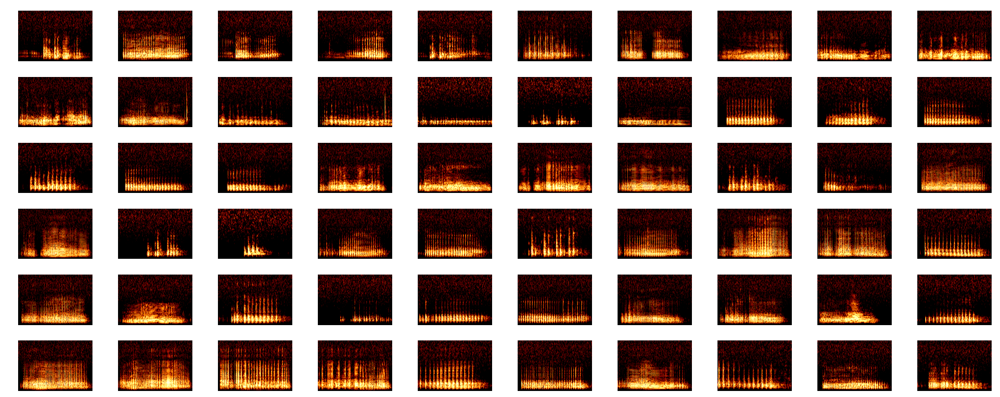


230
Fighting


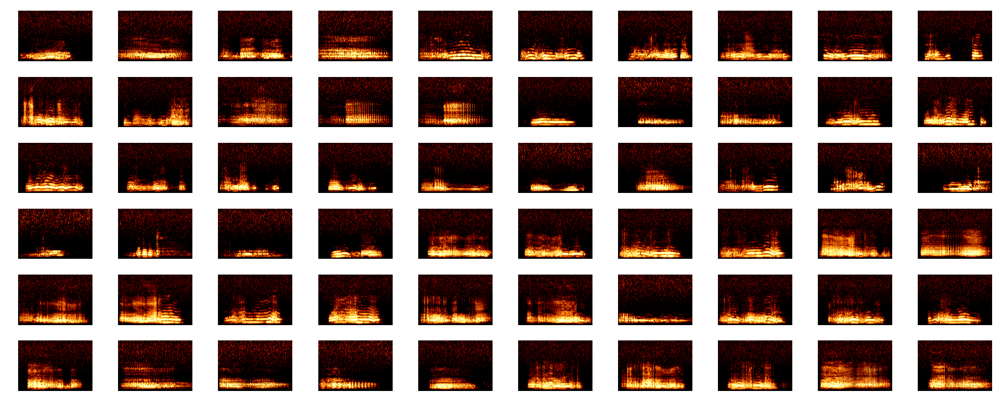


231
Fighting


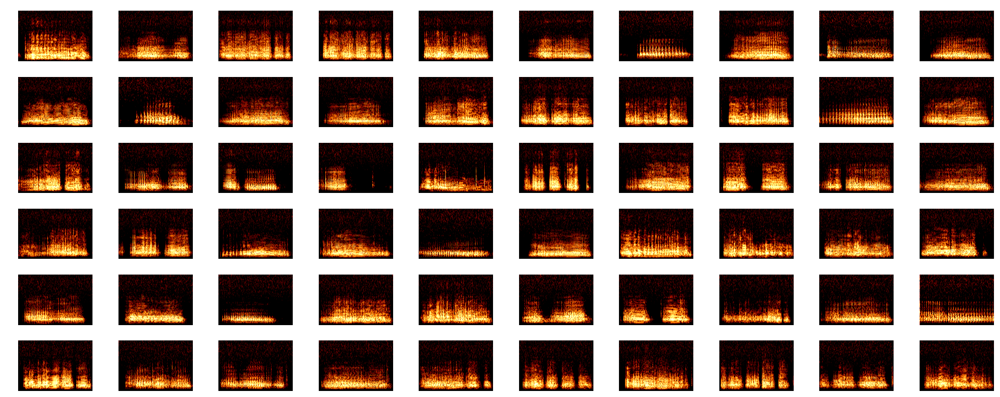


211
Fighting


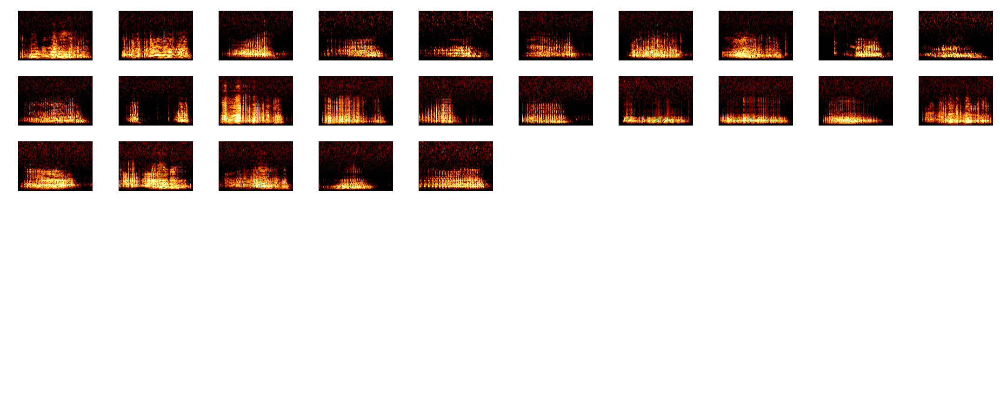


216
Fighting


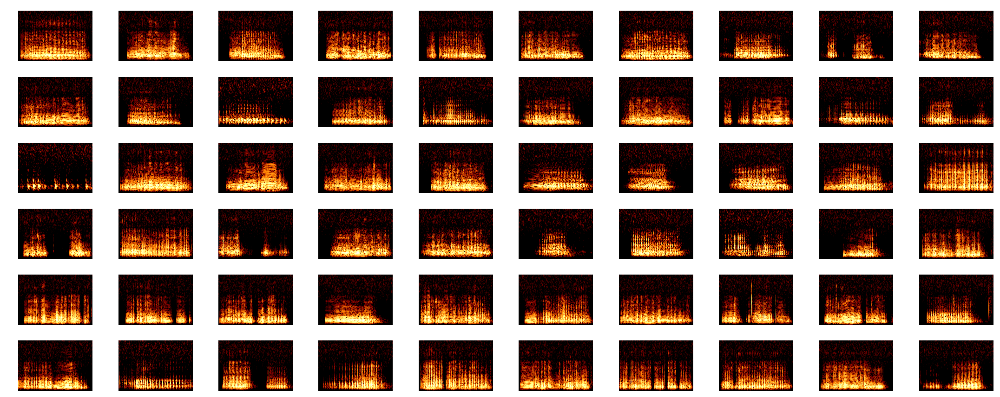


207
Fighting


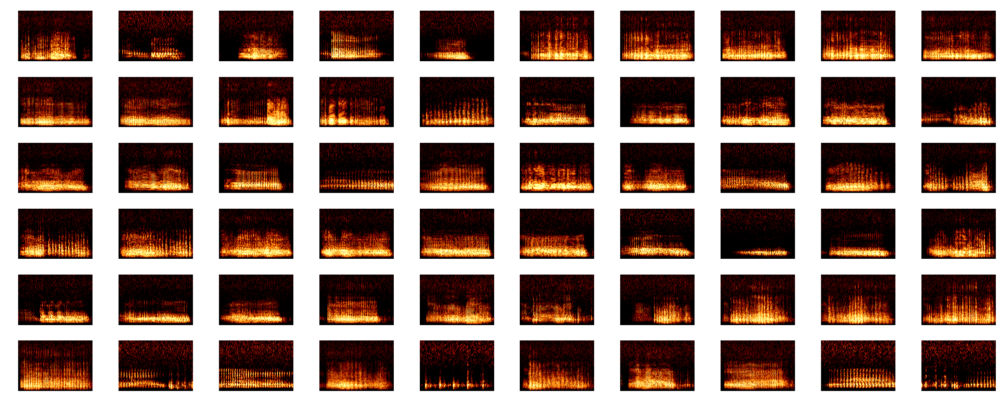


210
Fighting


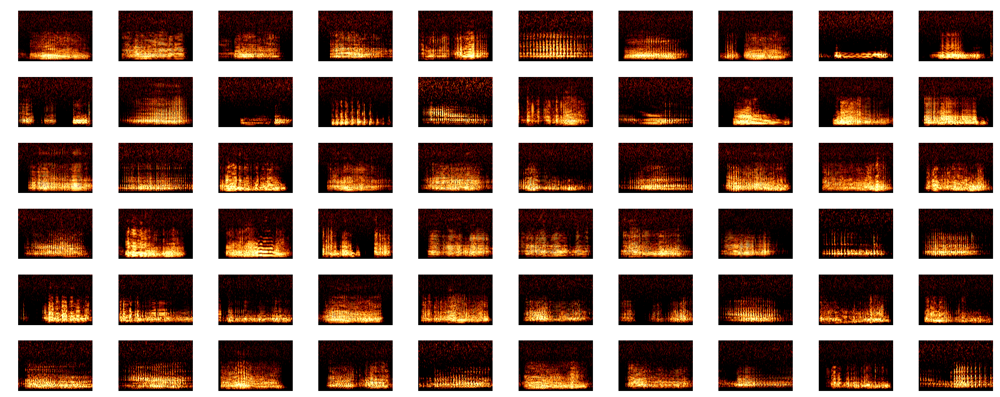


220
Fighting


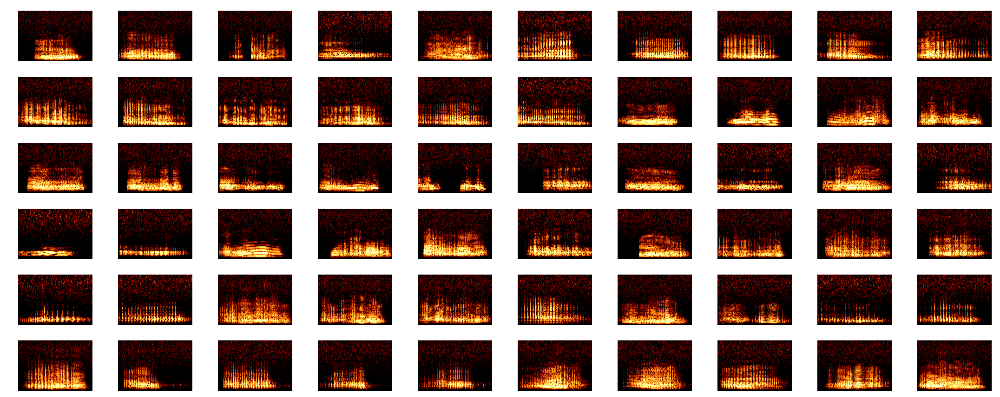


208
Fighting


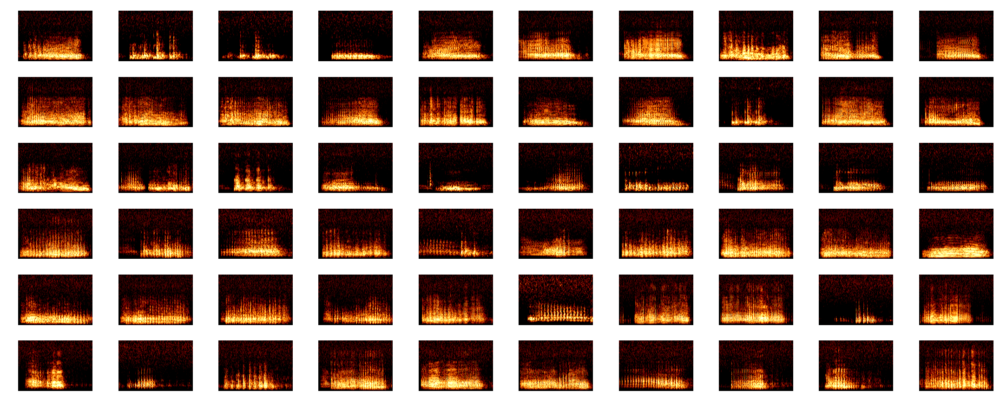


221
Fighting


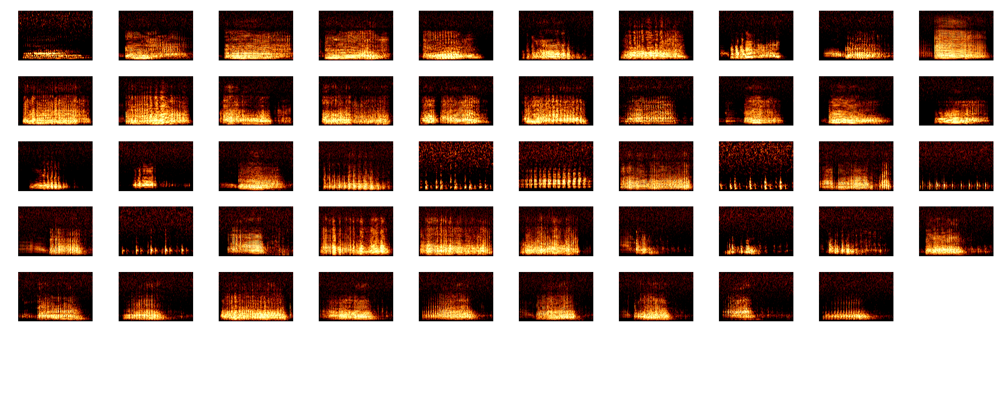

In [38]:
for indv, row in emitter_freq[emitter_freq.index > 0][:n_indv].iterrows():
    print(indv)
    # subset annotated data by that individual
    indv_annotations = annotations_on_disk[annotations_on_disk.Emitter == indv]
    # get context frequency
    indv_context_freq = pd.DataFrame({context: [np.sum(indv_annotations.Context == context)] for context in np.unique(indv_annotations.Context)}).T
    indv_context_freq.columns = ['N_voc']
    indv_context_freq = indv_context_freq.sort_values(by='N_voc', ascending=False)
    indv_context_freq['context']= [contexts[idx] for idx, row in indv_context_freq.iterrows()]
    indv_context_freq = indv_context_freq[indv_context_freq.context == 'Fighting']

    # loop through
    for ctxt, row in indv_context_freq[:n_contexts].iterrows():
        ctxt_annotations = indv_annotations[indv_annotations.Context == ctxt]
        print(row.context)
        # prepare the figure
        with tqdm(total=ncol*nrow) as pbar:
            pbar.set_description("examples")
            nex = 0
            fig, axs = plt.subplots(nrows = nrow, ncols=ncol, figsize=(ncol*zoom_x, nrow*zoom_y))
            for idx, row in ctxt_annotations.iterrows():    
                # get wav location of data
                voc_info = file_info_on_disk[file_info_on_disk.FileID == row.FileID]
                wav_path = DSLOC / voc_info['File folder'].values[0] / voc_info['File name'].values[0]
                # get start and end times from this file
                start_times = voc_info.values[:,6:][pd.isnull(voc_info.values[:,6:]) == False][::2]
                # get start and end times from this file
                end_times = voc_info.values[:,6:][pd.isnull(voc_info.values[:,6:]) == False][1:][::2]
                # load the data
                rate, data = load_wav(wav_path)
                for st, et in zip(start_times, end_times):
                    wav_spectrogram = spectrogram(int16_to_float32(data[int(st):int(et)]), param_dict["fruitbat"])
                    #axs.flatten()[nex].matshow(wav_spectrogram, origin='lower')
                    plot_spec(wav_spectrogram, fig=fig, ax=axs.flatten()[nex], show_cbar=False)
                    nex+=1
                    pbar.update(1)
                    if nex == nrow*ncol:
                        break
                if nex == nrow*ncol:
                        break
            for ax in axs.flatten():
                ax.axis('off')
            fig.tight_layout()
            plt.show()